## Make Augmented Patches

In this notebook we use a slightly different strategy to create the patches.  We randomly crop them from the label images, then augment (flip, rotate, rescale) them.

The augmentation could be done via a Pytorch 'Dataset'.  However in this case I wanted to explicitly save all the augmented patches so did it outside the Dataset. 


## Load the image and previous segmentations

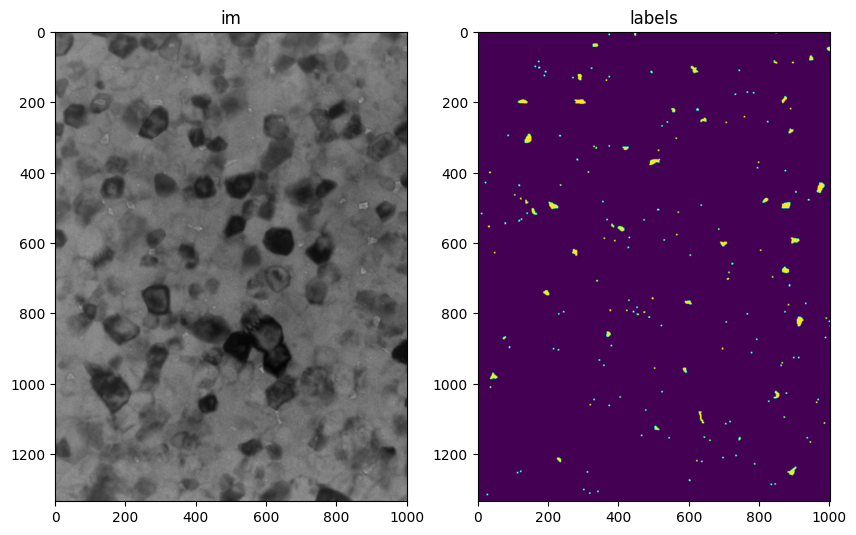

In [10]:
from skimage.io import imread, imsave
import napari
from tnia.deeplearning.dl_helper import make_patch_directory
from tnia.deeplearning.dl_helper import generate_patch_names
import os
from pathlib import Path
from tnia.plotting.plt_helper import imshow_multi2d
import numpy as np
import albumentations as A
import json
from data import quantile_normalization

tnia_images_path = Path(r'D:/images')
parent_path=Path(tnia_images_path / r'tnia-python-images/imagesc/2024_02_06_em_pores')
label_path = Path(parent_path / r'labels')
image_path = Path(label_path / r'inputs')
mask_path = Path(label_path / r'ground_truth')

name = 'test_1'

im = imread(os.path.join(image_path / (name+".tif")))
labels = imread(os.path.join(mask_path / (name+".tif")))

fig = imshow_multi2d([im, labels], ['im', 'labels'], 1,2, colormaps=['gray', 'viridis'], width = 10, height = 10)

## Make directories to save patches

In [11]:
patch_path= parent_path / 'patches' 
image_patch_path =  patch_path / 'input0'
label_patch_path =  patch_path / 'ground truth0'

if not os.path.exists(patch_path):
    os.mkdir(patch_path)
if not os.path.exists(image_patch_path):
    os.mkdir(image_patch_path)
if not os.path.exists(label_patch_path):
    os.mkdir(label_patch_path)

patch_base_name = name
axes = 'YX'
sub_sample = 1

make_patch_directory(1, 1, patch_path)

# Load the existing JSON data which is created when making the patch directory and append addition information to it
json_file = patch_path / "info.json"

with open(json_file, 'r') as infile:
    data = json.load(infile)

# add the sub_sample information to the JSON file
data['sub_sample'] = sub_sample 
data['axes'] = axes

# Write the modified data back to the JSON file
with open(json_file, 'w') as outfile:
    json.dump(data, outfile)


## Normalize Image

Normalize the image before creating patches.  This is a subtle issue.  Alternatively we could normalize each patch.  The former is used because when we apply to a real image we usually normalize using the range of the entire image, and we want training and prediction to use a similar strategy. 

In [12]:
im_min = im.min()
im_max = im.max()
im, _, _ = quantile_normalization(im)

## Create random patches

We randomly crop a p by p (where p is the patch size) section from the image then apply the augmentation function.  The augmentation function is composed of Flips, Rotations, and resizing.  We can also potentially apply intensity transforms. 

(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_0.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_0.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_0.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_1.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_1.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_2.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_2.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_3.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_3.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_4.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_4.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_5.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_5.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_1.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_2.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_3.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_4.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tn

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_6.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_6.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_7.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_7.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_8.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_8.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_9.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_9.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_10.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_10.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_6.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_7.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_8.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_9.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tn

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_11.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_11.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_12.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_12.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_11.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_12.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_13.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_13.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_14.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_14.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_15.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_15.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_16.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_16.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_17.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_17.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_13.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_14.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_15.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_16.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_18.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_18.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_19.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_19.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_20.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_20.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_21.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_21.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_22.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_22.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_18.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_19.tif is a low contrast image
  imsave(patch_name, label_aug)
c:\users\bnort\work\imagej2022\tnia\tnia-python\tnia\plotting\plt_helper.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(rows, cols, figsize=(width,height))
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_23.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_23.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_24.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_24.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_25.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_25.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_26.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_26.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_27.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_27.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_23.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_24.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_25.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_26.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_28.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_28.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_28.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_29.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_29.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_30.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_30.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_31.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_31.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_32.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_32.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_33.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_33.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_29.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_30.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_31.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_32.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_34.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_34.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_35.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_35.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_36.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_36.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_37.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_37.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_38.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_38.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_34.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_35.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_36.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_37.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_39.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_39.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_40.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_40.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_41.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_41.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_42.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_42.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_43.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_43.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_39.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_40.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_41.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_42.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_44.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_44.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_45.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_45.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_46.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_46.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_47.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_47.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_44.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_45.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_46.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_47.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_48.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_48.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_49.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_49.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_50.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_50.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_51.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_51.tif


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_48.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_49.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_50.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_51.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_52.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_52.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_53.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_53.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_54.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_54.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_55.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_55.tif


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_55.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_56.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_57.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_58.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_56.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_56.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_57.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_57.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_58.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_58.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_59.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_59.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_60.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_60.tif
(448,

C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_61.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_62.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_63.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_64.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_66.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_66.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_67.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_67.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_68.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_68.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_69.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_69.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_70.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_70.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_66.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_67.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_68.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_69.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_71.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_71.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_72.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_72.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_71.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_72.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_73.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_73.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_74.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_74.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_75.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_75.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_76.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_76.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_77.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_77.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_73.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_74.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_75.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_76.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_78.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_78.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_79.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_79.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_80.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_80.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_81.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_81.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_82.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_82.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_78.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_79.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_80.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_81.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_83.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_83.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_84.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_84.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_85.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_85.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_86.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_86.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_87.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_87.tif


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_83.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_84.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_85.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_86.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_88.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_88.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_89.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_89.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_90.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_90.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_91.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_91.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_88.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_89.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_90.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_91.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\image

D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_92.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_92.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_93.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_93.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_94.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_94.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_95.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_95.tif
(448, 448) (448, 448)


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_93.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_94.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_95.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_96.tif is a low contrast image
  imsave(patch_name, label_aug)


D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_96.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_96.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_97.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_97.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_98.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_98.tif
(448, 448) (448, 448)
D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\input0/roots_99.tif D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_99.tif


C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_97.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_98.tif is a low contrast image
  imsave(patch_name, label_aug)
C:\Users\bnort\AppData\Local\Temp\ipykernel_28732\806333609.py:43: UserWarning: D:\images\tnia-python-images\imagesc\2024_02_06_em_pores\patches\ground truth0/roots_99.tif is a low contrast image
  imsave(patch_name, label_aug)


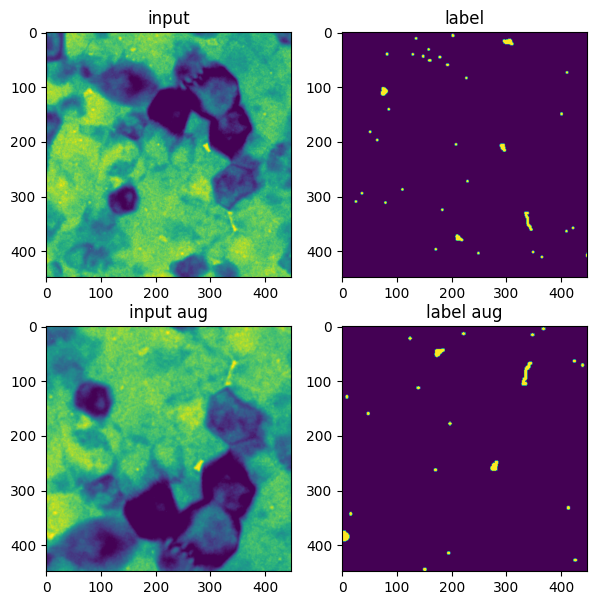

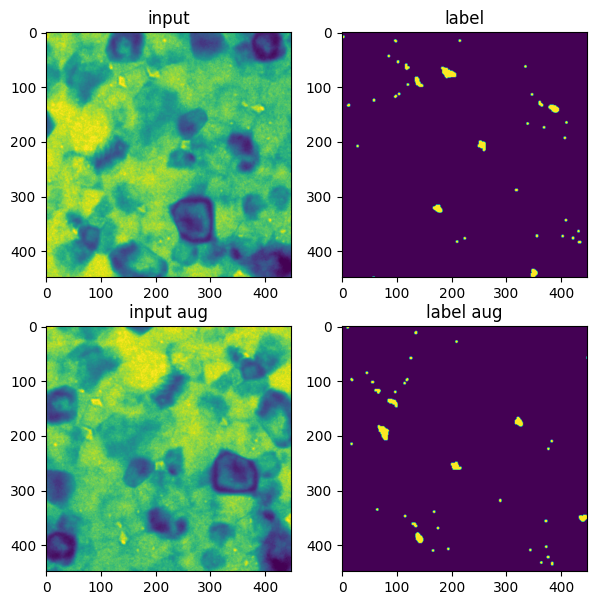

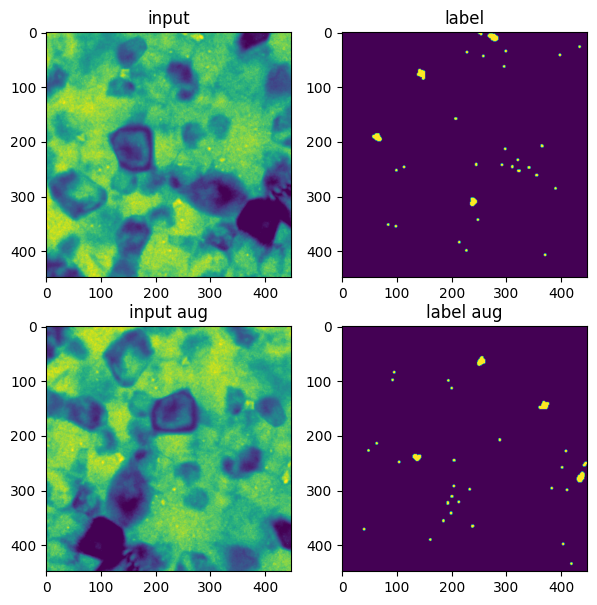

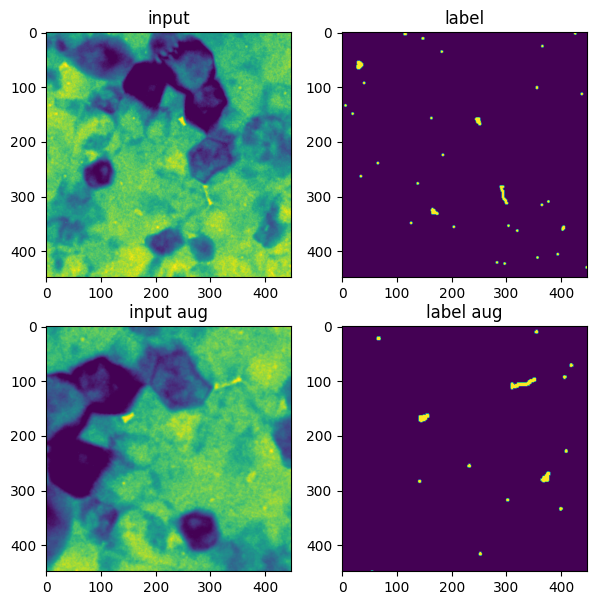

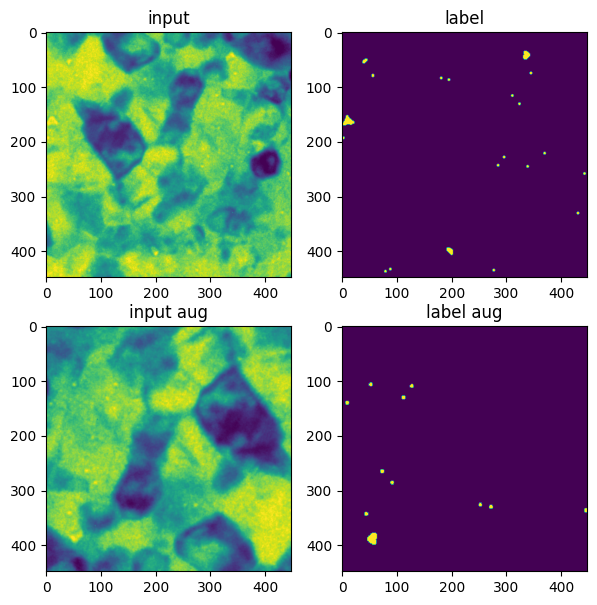

...

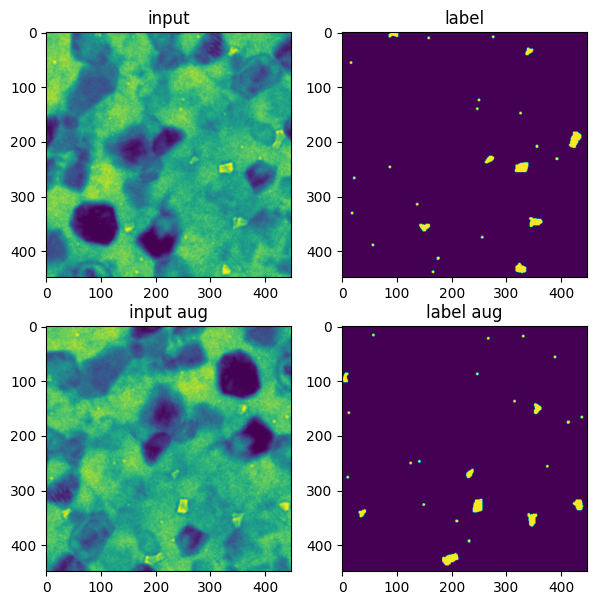

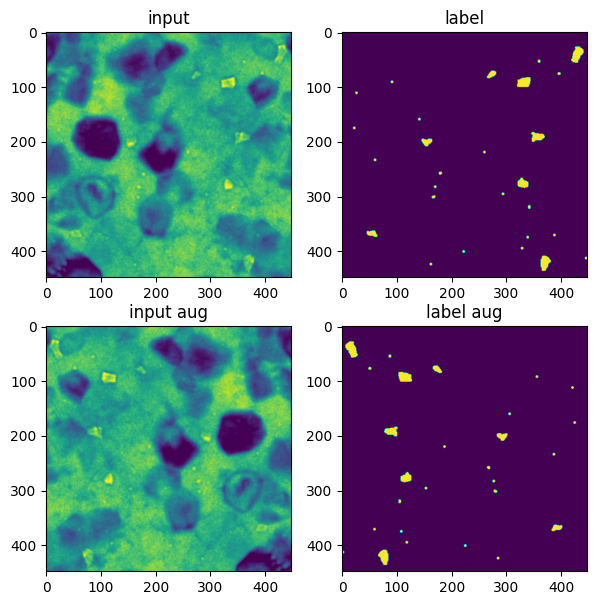

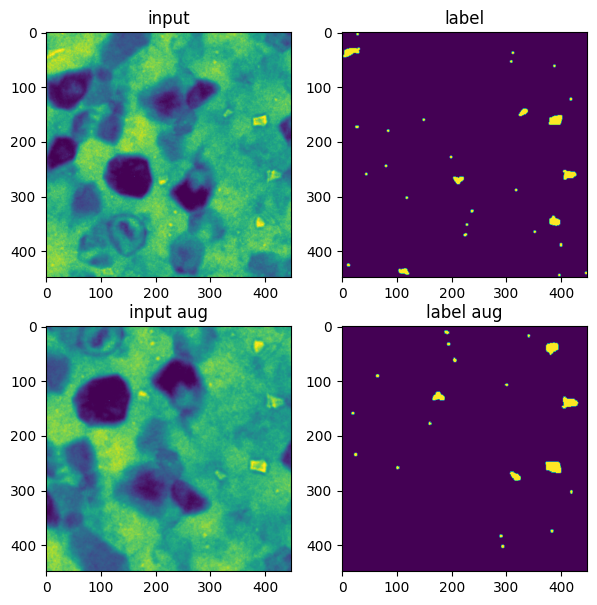

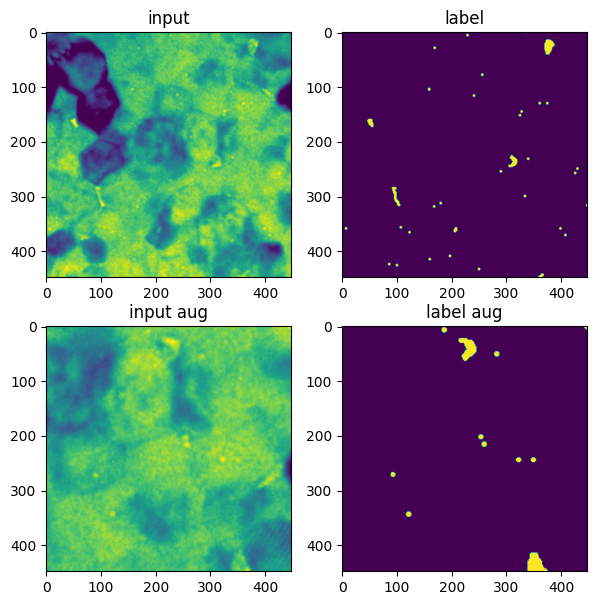

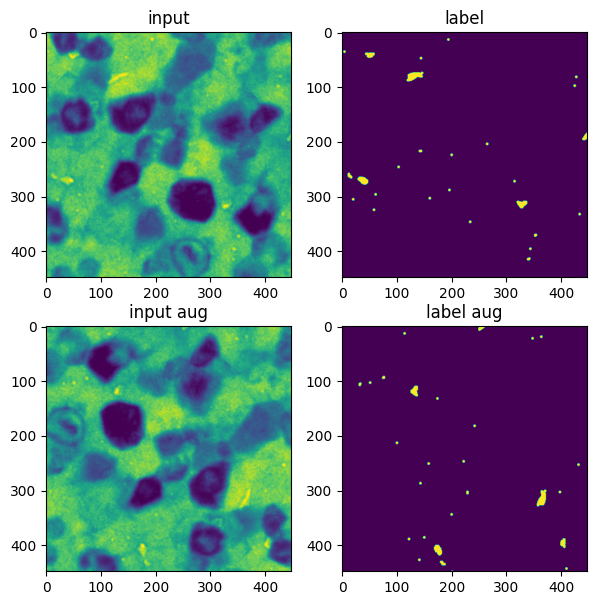

In [13]:
from random import randint
import numpy as np

patch_size = 448

num_patches = 100

for i in range(num_patches):
    x=randint(0,im.shape[1]-patch_size-1)
    y=randint(0,im.shape[0]-patch_size-1)

    ind = np.s_[y:y+patch_size, x:x+patch_size]
        
    aug = A.Compose([
        A.VerticalFlip(p=0.5),
        A.HorizontalFlip(p=0.5),              
        A.RandomRotate90(p=0.5),
        A.RandomSizedCrop(min_max_height=(patch_size//2, patch_size), height=patch_size, width=patch_size, p=0.5),
        #A.RandomBrightnessContrast(p=0.8),
        #A.RandomGamma(p=0.8),
        ]
    )

    augmented = aug(image=im[ind], mask=labels[ind])

    im_aug = augmented['image']
    label_aug = augmented['mask']

    print(im_aug.shape, label_aug.shape)

    fig = imshow_multi2d([im[ind], labels[ind], im_aug, label_aug], ['input', 'label','input aug', 'label aug'], 2,2, width=7, height=7)

    patch_base_name = 'roots'

    image_name, patch_name = generate_patch_names(str(image_patch_path), str(label_patch_path), patch_base_name)
    print(image_name, patch_name)
    imsave(image_name, im_aug)
    imsave(patch_name, label_aug)

In [14]:
im.min(), im.max()

(0.0, 1.0)